In [2]:
from ripser import ripser
from persim import plot_diagrams
from numpy import sin,cos, dot
import numpy as np
from numpy import pi,cos,sin
import matplotlib.pyplot as plt
import random
from math import dist

In [192]:
 def graph_continuous(image_function, x, y, x_random = True, n_samples= 100000, y_random = True):
    
    if x_random == True:
        X = list(2 * x * np.random.random(n_samples) - x) 
        if y_random == True:
            Y = list(2 * y * np.random.random(n_samples) - y) 
        else:
            Y = np.linspace(-y,y,n_samples)      

    if x_random == False:
        X = np.linspace(-x,x,n_samples)
        if y_random == True:
            Y = list(2 * y * np.random.random(n_samples) - y) 
        else:
            Y = np.linspace(-y,y,n_samples)   

    x_points = []
    y_points = []
    colors = []
    for i in range(n_samples):
        color = image_function(X[i],Y[i]) 
        colors.append(color)
        x_points.append(X[i])
        y_points.append(Y[i])

        
    fig = plt.figure(figsize = (4, 4))
    ax = plt.axes()
    ax.scatter(x_points, y_points, c = colors, s = .1)
    plt.show()
    
    
def view_window_continuous(image_function, num_pixels, window_size):
    
    pixels = get_pixels(num_pixels, window_size)
            
    x_points = []
    y_points = []
    colors = []
    for i in range(len(pixels)):
        color = image_function(pixels[i][0],pixels[i][1]) 
        colors.append(color)
        x_points.append(pixels[i][0])
        y_points.append(pixels[i][1])
    
    fig = plt.figure(figsize = (4, 4))
    ax = plt.axes()
    ax.scatter(x_points, y_points, c = colors)
    plt.show()
    
def view_isom(a, b, theta , image_function, num_pixels, window_size):
    
    pixels = get_pixels(num_pixels, window_size)
    
    iso_inv = isom(-1 * a,-1 * b,2 * pi - theta)
    
    pixels_inv = []
    for pixel in pixels: 
        pixels_inv.append(iso_inv(pixel[0], pixel[1]))
    
    x_points = []
    y_points = []
    colors = []
    for i in range(len(pixels_inv)):
        color = image_function(pixels_inv[i][0],pixels_inv[i][1]) 
        colors.append(color)
        x_points.append(pixels[i][0])
        y_points.append(pixels[i][1])  

    fig = plt.figure(figsize = (4, 4))
    ax = plt.axes()
    ax.scatter(x_points, y_points, c = colors)
    plt.show()

    
def get_pixels(num_pixels, window_size):
    sample = list(np.linspace(-window_size/2, window_size/2, num_pixels))
    pixels = []
    for i in range(len(sample)):
        for j in range(len(sample)):
            pixels.append((sample[i],sample[j]))     
    return pixels


def get_colors(pixels, image_function):
    colors = []
    for pixel in pixels:
        colors.append(image_function(pixel[0],pixel[1]))
    return colors  

def translation(a,b):
    def t_ab(x,y): 
        return x+a, y+b
    return t_ab

def rotation(theta):
    def r_theta(x,y):
        return x * cos(theta) - y * sin(theta), x * sin(theta) + y * cos(theta)
    return r_theta

def isom(a,b,theta):
    def iso(x,y):
        r = rotation(theta)
        t = translation(a,b)
        return t(r(x,y)[0], r(x,y)[1])
    return iso

def generate_isom_track(n_isos, x_translate, y_translate):
    a = list(2 * x_translate * np.random.random(n_isos) - x_translate) # sampling from (-x,x)
    b = list(2 * y_translate * np.random.random(n_isos) - y_translate) # sampling from (-y,y)
    theta = list(2 * pi * np.random.random(n_isos)) # sampling from (0, 2pi)

    isos = []
    isos_inv = []
    for i in range(n_isos):
        isos.append((theta[i], isom(a[i], b[i], theta[i])))
        isos_inv.append((-theta[i],isom(-1 * a[i],-1 * b[i],2 * pi - theta[i])))
    return isos_inv

def new_colors(pixels, iso_inv, image_function):
    pixels_inv = []
    for pixel in pixels: 
        pixels_inv.append(iso_inv(pixel[0], pixel[1]))
    new_colors = get_colors(pixels_inv, image_function)
    return new_colors


def matrix_theta_lens(pixels, isos_inv, image_function):
    vectors = np.zeros((len(isos_inv), len(pixels)+1))
    for i in range(len(isos_inv)):
        colors = new_colors(pixels, isos_inv[i][1], image_function)
        colors.insert(0, isos_inv[i][0])
        vectors[i] = colors
    return vectors


def p_hom(M, maxdim, coeff):
    output = ripser(M, maxdim = maxdim, coeff = coeff)
    return output
    
def persistent_H1_intervals(output):
    H1 = output['dgms'][1].tolist() # all intervals in H1
    d = []
    for pair in H1: 
        d.append(pair[1] - pair[0]) # finding lengths of intervals in H1
    d.sort(reverse = True) # sorting from longest to shortest intervals
    d
    return d

def plot_dgms(output):
    dgms = output['dgms']
    fig = plt.figure(figsize = (12, 6))
    plot_diagrams(dgms)
    
    
def pipeline(image_function, num_pixels, window_size, n_isos, x_translate, y_translate, maxdim, coeff):
    pixels = get_pixels(num_pixels, window_size)
    isos_inv = generate_isom(n_isos, x_translate, y_translate)
    M = matrix_of_images(pixels, isos_inv, image_function)
    output = p_hom(M, maxdim, coeff)
    return output


def view_isom2(isom_inv, image_function, num_pixels, window_size):
    
    pixels = get_unitsq_pixels(num_pixels, window_size)
    
    pixels_inv = []
    for pixel in pixels: 
        pixels_inv.append(isom_inv(pixel[0], pixel[1]))
    
    x_points = []
    y_points = []
    colors = []
    for i in range(len(pixels_inv)):
        color = image_function(pixels_inv[i][0],pixels_inv[i][1]) 
        colors.append(color)
        x_points.append(pixels[i][0])
        y_points.append(pixels[i][1])  

    fig = plt.figure(figsize = (4, 4))
    ax = plt.axes()
    ax.scatter(x_points, y_points, c = colors)
    plt.show()
    

def compose_isoms(i1,i2, i3):
    def comp(x,y):
        x2 = i1(x,y)[0]
        y2 = i1(x,y)[1]
        x3 = i2(x2,y2)[0]
        y3 = i2(x2,y2)[1]
        return i3(x3,y3)
    return comp


def get_unitsq_pixels(num_pixels, window_size):
    sample = list(np.linspace(0, window_size, num_pixels))
    pixels = []
    for i in range(len(sample)):
        for j in range(len(sample)):
            pixels.append((sample[i],sample[j]))     
    return pixels

    
def get_matrix_pixels(num_pixels, window_size):
    sample = list(np.linspace(0, window_size, num_pixels))
    pixels = []
    for i in range(len(sample)):
        for j in range(len(sample)):
            pixels.append((sample[i],sample[j]))     
    return pixels

def view_dist_matrix(matrix, num_pixels, window_size, title):
    
    pixels = get_matrix_pixels(num_pixels, window_size)
    
    x_points = []
    y_points = []
    for i in range(len(pixels)):
        x_points.append(pixels[i][0])
        y_points.append(pixels[i][1])
    
    fig = plt.figure(figsize = (7, 7))
    ax = plt.axes()
    plt.title(title)
    plt.xlabel('indexed images')
    plt.ylabel('indexed images') 
    scatter = ax.scatter(x_points, y_points, c = np.concatenate(matrix),cmap='viridis')
    plt.legend(*scatter.legend_elements())
    plt.show()

# C3

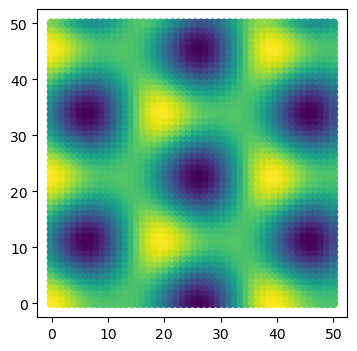

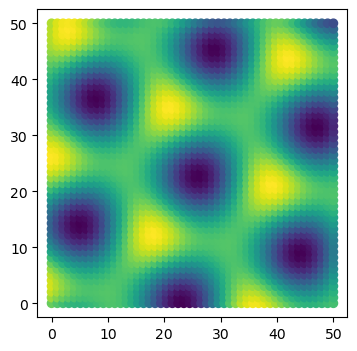

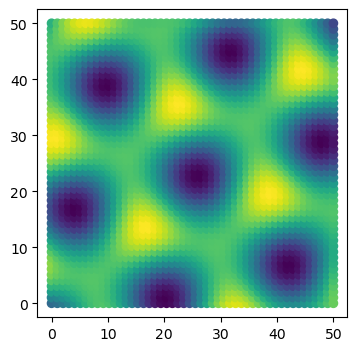

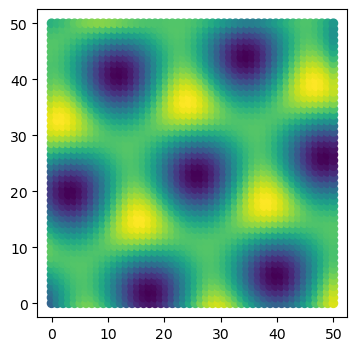

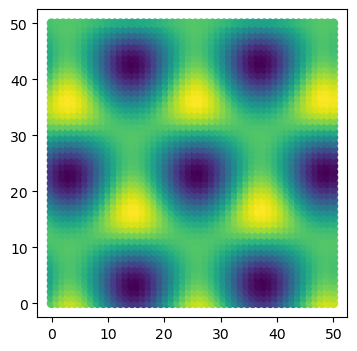

...

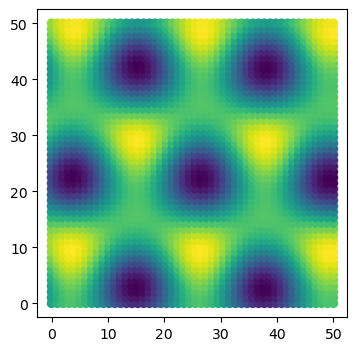

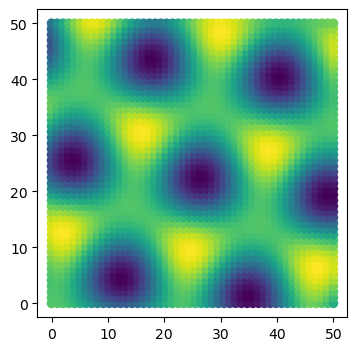

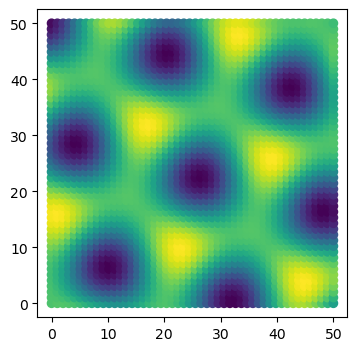

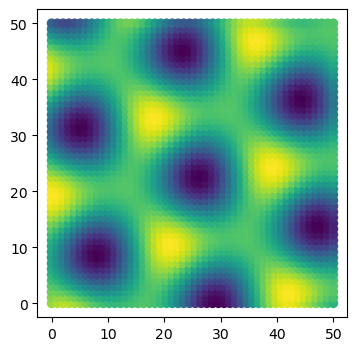

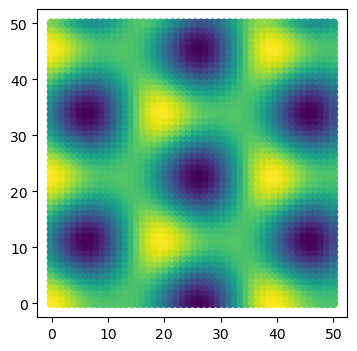

In [274]:
def p3(x,y):
    X = 1/(2 * pi) * (x + y / (3**(1/2)))
    Y = 1/(2 * pi) * 2 * y / (3**(1/2))
    C = cos(X + Y) + cos(X - 2 * Y) + cos(-2 * X + Y)
    S = sin(X + Y) +sin(X - 2*Y) +sin(-2 * X + Y)
    return C + S

# purple dot
isoms = []
for i in range(50):
    theta = (2*pi)/49 * i 
    isom1 = isom(-27,-23.5,0)
    isom2 = isom(0,0,theta)
    isom3 = isom(27,23.5,0)
    f = compose_isoms(isom1,isom2,isom3)
    isoms.append((theta, f))
    
points_in_R400 = []
for pair in isoms:
    view_isom2(isom_inv = pair[1],image_function =p3, num_pixels = 50, window_size =50)
    pixels = get_unitsq_pixels(num_pixels = 50, window_size=50)
    point = new_colors(pixels, iso_inv=pair[1], image_function=p3)
    point.insert(0, pair[0])
    points_in_R400.append(point)

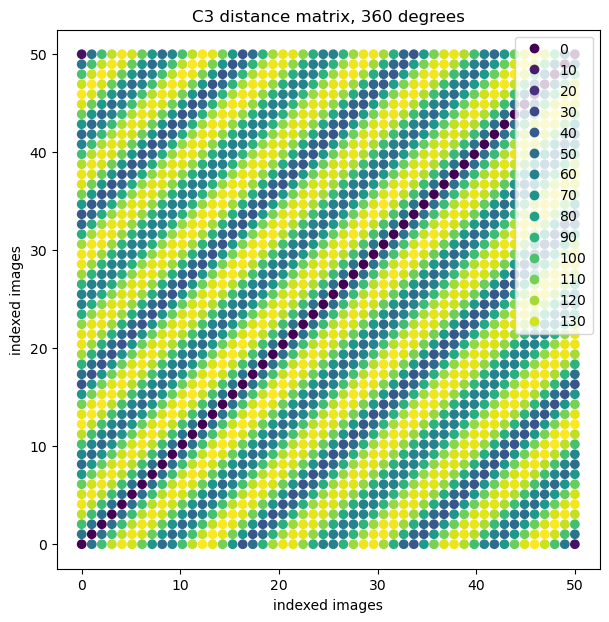

In [194]:
M = np.zeros((50,50))
for i in range(50):
    for j in range(50):
        M[i][j] = dist(points_in_R400[i], points_in_R400[j])
view_dist_matrix(matrix=M, num_pixels=50, window_size=50, title = 'C3 distance matrix, 360 degrees')

In [120]:
pixels = get_pixels(num_pixels = 30, window_size = 60)
isos_inv = generate_isom_track(n_isos = 1000, x_translate= 1000, y_translate= 1000)
vectors = matrix_theta_lens(pixels, isos_inv, image_function = p3)

In [195]:
def dist_penalize(lens1, lens2):
    if pi - 0.5 < abs(lens1[0] - lens2[0]) < pi + 0.5:
        ret = 100 * dist(lens1[1:], lens2[1:])
    else:
        ret = dist(lens1[1:], lens2[1:])
    return ret

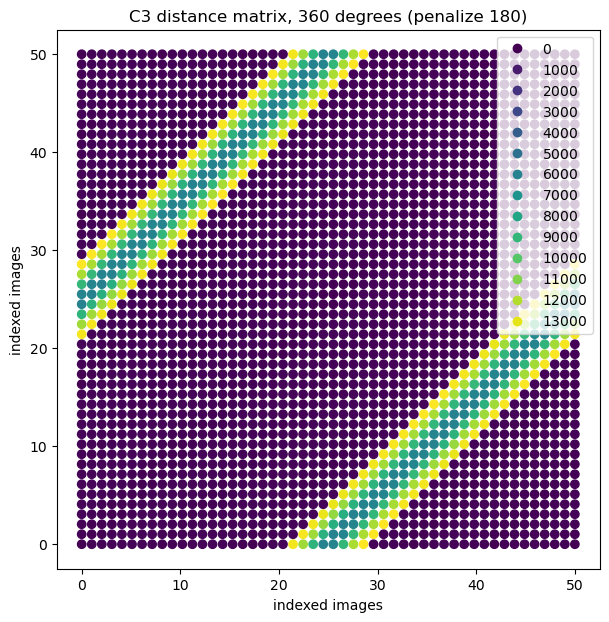

In [196]:
M = np.zeros((50,50))
for i in range(50):
    for j in range(50):
        M[i][j] = dist_penalize(points_in_R400[i], points_in_R400[j])
view_dist_matrix(matrix=M, num_pixels=50, window_size=50, title = 'C3 distance matrix, 360 degrees (penalize 180)')

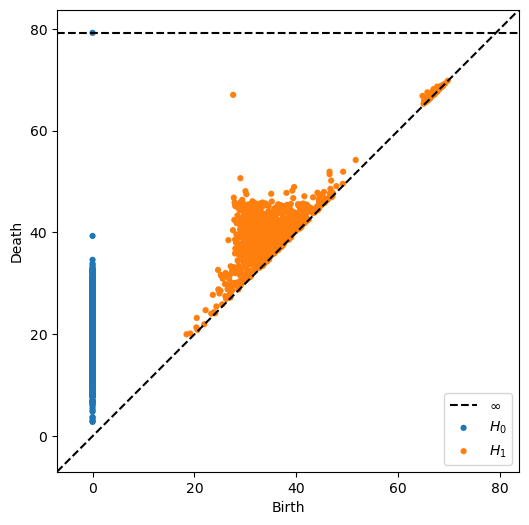

In [197]:
output = ripser(vectors, maxdim=1, coeff=2, metric=dist_penalize)
plot_dgms(output)

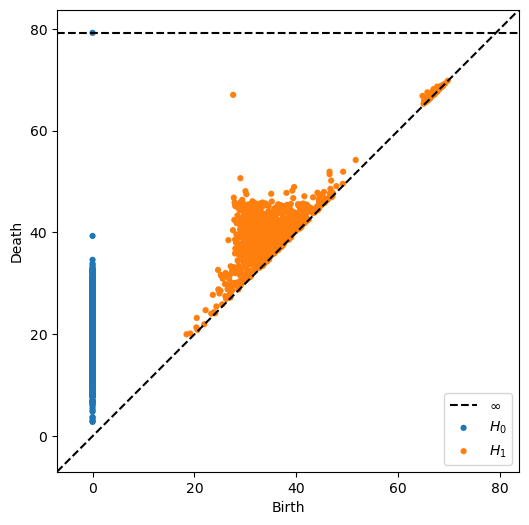

In [198]:
output = ripser(vectors, maxdim=1, coeff=3, metric=dist_penalize)
plot_dgms(output)

In [205]:
def dist_penalize(lens1, lens2):
    if (pi/3 - 0.1 < abs(lens1[0] - lens2[0]) < pi/3 + 0.1)  or (pi - 0.1 < abs(lens1[0] - lens2[0]) < pi + 0.1)  or (5*pi/3 - 0.1 < abs(lens1[0] - lens2[0]) < 5*pi/3 + 0.1):
        ret = 3 * dist(lens1[1:], lens2[1:])
    else:
        ret = dist(lens1[1:], lens2[1:])
    return ret

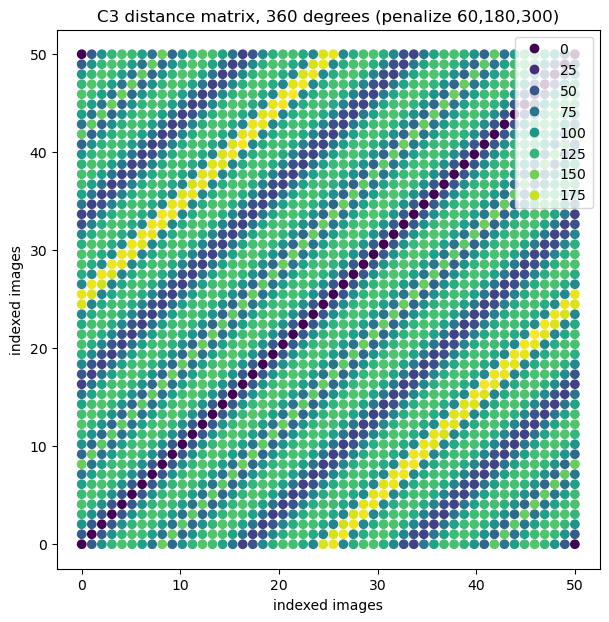

In [206]:
M = np.zeros((50,50))
for i in range(50):
    for j in range(50):
        M[i][j] = dist_penalize(points_in_R400[i], points_in_R400[j])
view_dist_matrix(matrix=M, num_pixels=50, window_size=50, title = 'C3 distance matrix, 360 degrees (penalize 60,180,300)')

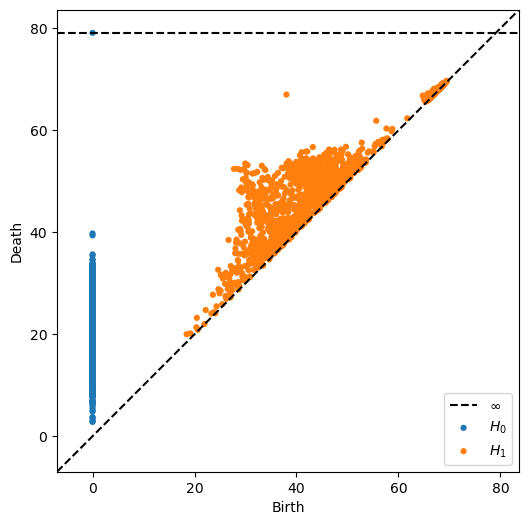

In [207]:
output = ripser(vectors, maxdim=1, coeff=2, metric=dist_penalize)
plot_dgms(output)

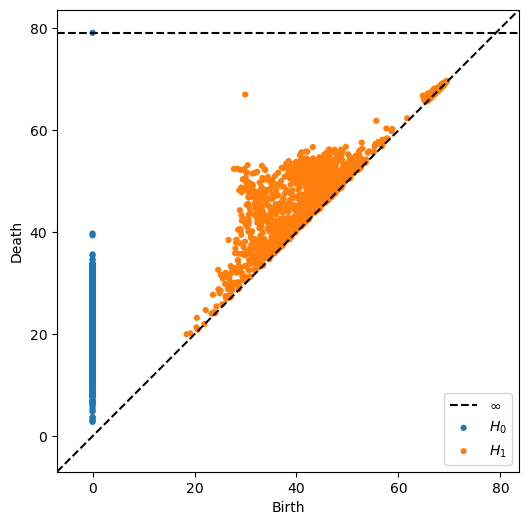

In [208]:
output = ripser(vectors, maxdim=1, coeff=3, metric=dist_penalize)
plot_dgms(output)

In [306]:
def dist_penalize(lens1, lens2):
    if (pi/3 - 0.2 < abs(lens1[0] - lens2[0]) < pi/3 + 0.2) or (pi - 0.2 < abs(lens1[0] - lens2[0]) < pi + 0.2) or (5*pi/3 - 0.2 < abs(lens1[0] - lens2[0]) < 5*pi/3 + 0.2):
        ret = 2 * dist(lens1[1:], lens2[1:])
    else:
        ret = dist(lens1[1:], lens2[1:])
    return ret

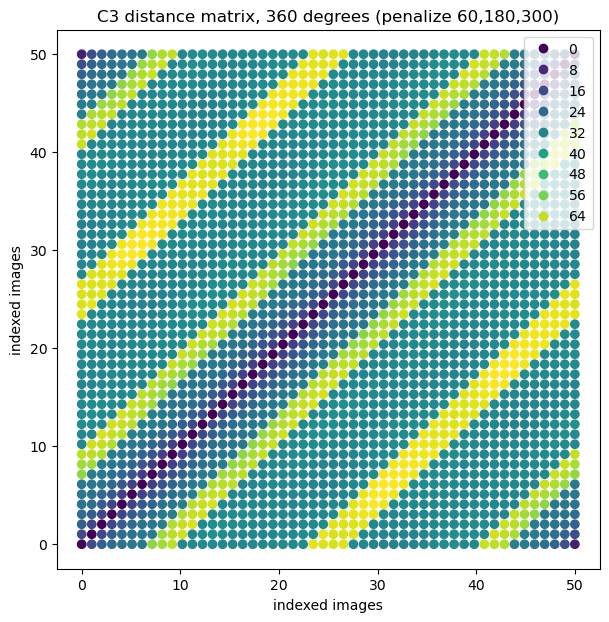

In [307]:
M = np.zeros((50,50))
for i in range(50):
    for j in range(50):
        M[i][j] = dist_penalize(points_in_R400[i], points_in_R400[j])
view_dist_matrix(matrix=M, num_pixels=50, window_size=50, title = 'C3 distance matrix, 360 degrees (penalize 60,180,300)')

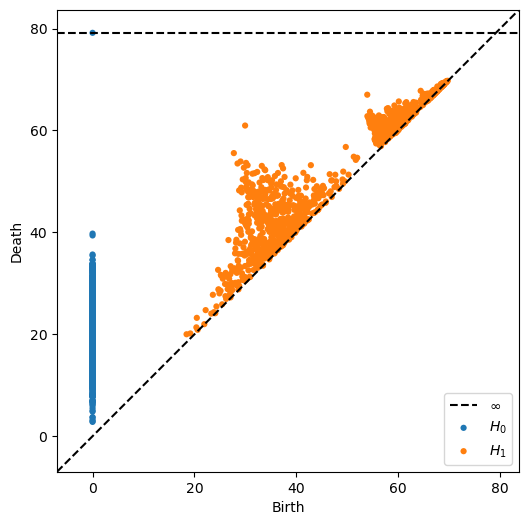

In [312]:
output = ripser(vectors, maxdim=1, coeff=2, metric=dist_penalize)
plot_dgms(output)

In [313]:
persistent_H1_intervals(output)

[31.02741241455078,
 27.83477783203125,
 25.068788528442383,
 24.86237907409668,
 23.50466537475586,
 23.004858016967773,
 22.74049186706543,
 21.382823944091797,
 20.918704986572266,
 20.614822387695312,
 20.131649017333984,
 19.853044509887695,
 19.83590316772461,
 19.81192970275879,
 19.604934692382812,
 19.545177459716797,
 19.476415634155273,
 19.19102668762207,
 18.810396194458008,
 18.615402221679688,
 18.583284378051758,
 18.318363189697266,
 18.242252349853516,
 18.139602661132812,
 17.84613800048828,
 17.775938034057617,
 17.464618682861328,
 17.33769989013672,
 17.25735092163086,
 17.009109497070312,
 16.736141204833984,
 16.54160499572754,
 16.466087341308594,
 16.453636169433594,
 16.43463897705078,
 16.384092330932617,
 16.37757682800293,
 16.34159278869629,
 16.176679611206055,
 16.138309478759766,
 16.087383270263672,
 15.97662353515625,
 15.880769729614258,
 15.789878845214844,
 15.741539001464844,
 15.631038665771484,
 15.460041046142578,
 15.425312042236328,
 15.3773

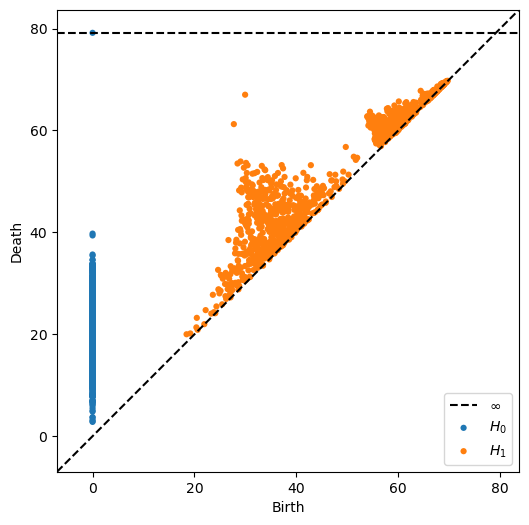

In [309]:
output = ripser(vectors, maxdim=1, coeff=3, metric=dist_penalize)
plot_dgms(output)

In [314]:
def dist_penalize(lens1, lens2):
    if pi - pi/2 < abs(lens1[0] - lens2[0]) < pi + pi/2:
        ret = (1 - cos(abs(lens1[0] - lens2[0]))) * dist(lens1[1:], lens2[1:])
    else:
        ret = dist(lens1[1:], lens2[1:])
    return ret

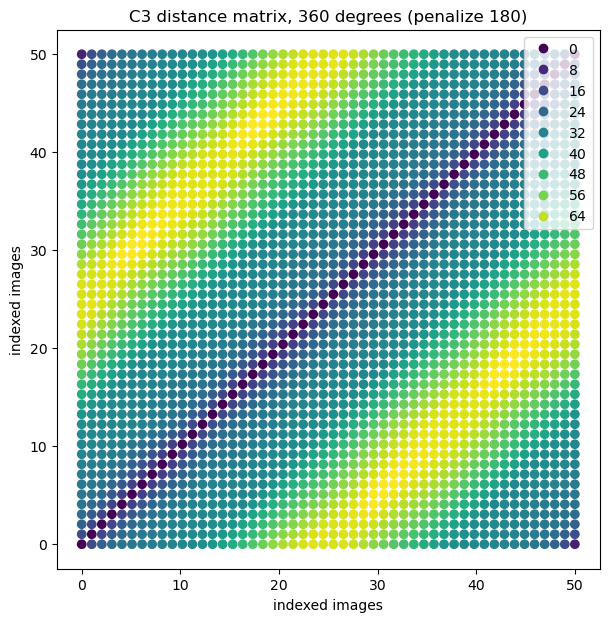

In [316]:
M = np.zeros((50,50))
for i in range(50):
    for j in range(50):
        M[i][j] = dist_penalize(points_in_R400[i], points_in_R400[j])
view_dist_matrix(matrix=M, num_pixels=50, window_size=50, title = 'C3 distance matrix, 360 degrees (penalize 180)')

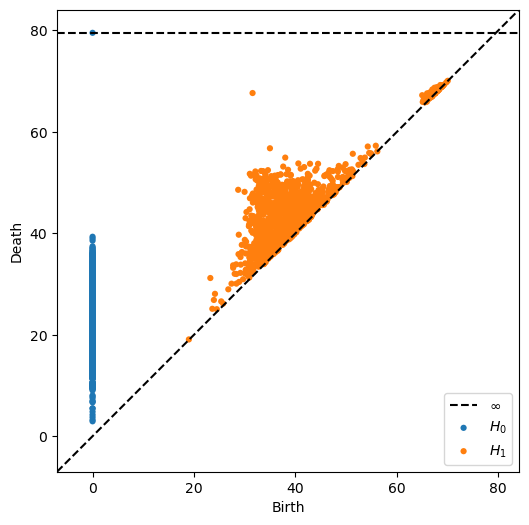

In [218]:
output = ripser(vectors, maxdim=1, coeff=2, metric=dist_penalize)
plot_dgms(output)

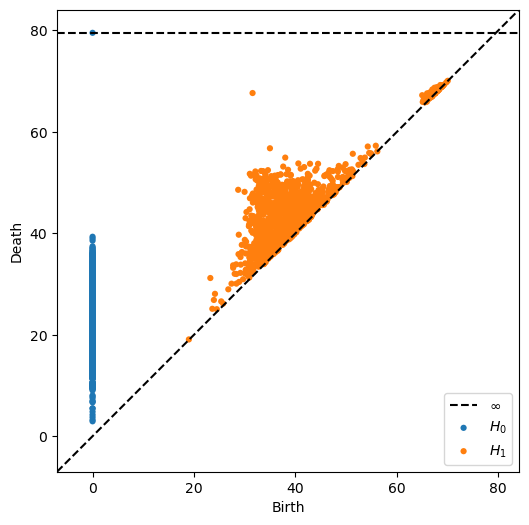

In [219]:
output = ripser(vectors, maxdim=1, coeff=3, metric=dist_penalize)
plot_dgms(output)

In [222]:
def dist_penalize(lens1, lens2):
    if pi - .1 < abs(lens1[0] - lens2[0]) < pi + .1:
        ret = (1 - cos(abs(lens1[0] - lens2[0]))) * dist(lens1[1:], lens2[1:])
    else:
        ret = dist(lens1[1:], lens2[1:])
    return ret

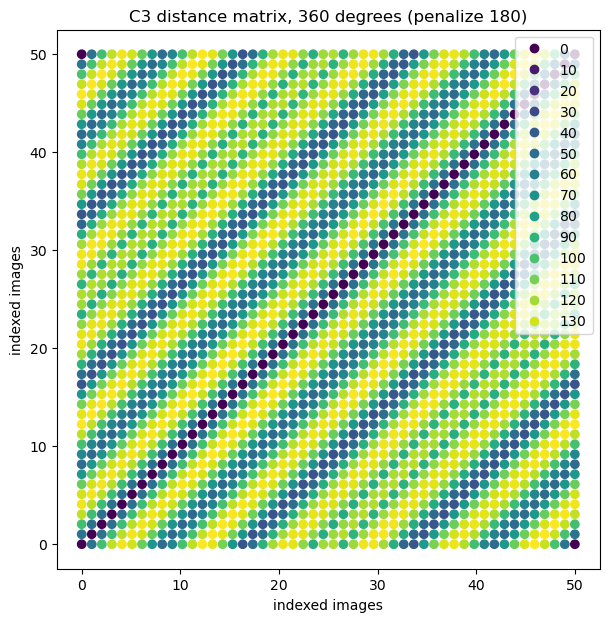

In [223]:
M = np.zeros((50,50))
for i in range(50):
    for j in range(50):
        M[i][j] = dist_penalize(points_in_R400[i], points_in_R400[j])
view_dist_matrix(matrix=M, num_pixels=50, window_size=50, title = 'C3 distance matrix, 360 degrees (penalize 180)')

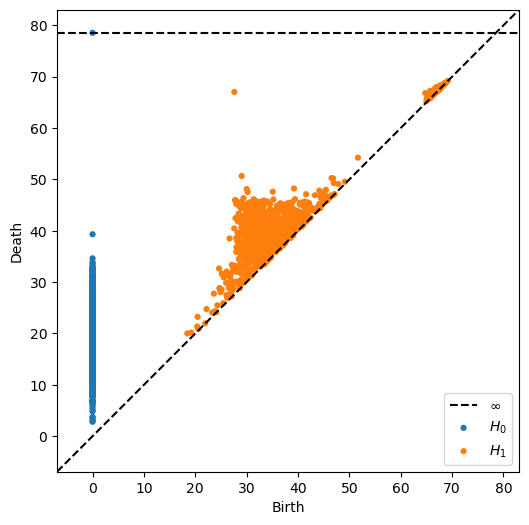

In [224]:
output = ripser(vectors, maxdim=1, coeff=2, metric=dist_penalize)
plot_dgms(output)

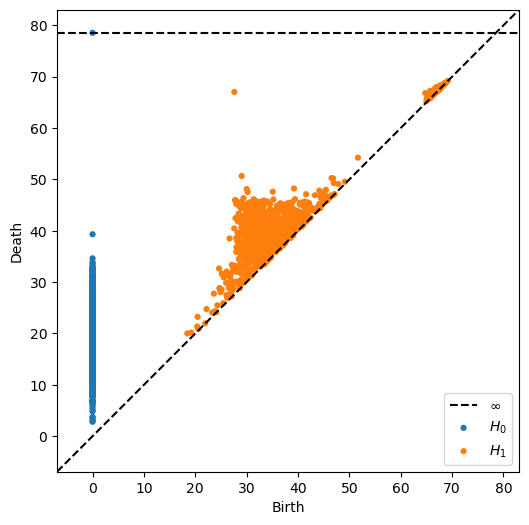

In [225]:
output = ripser(vectors, maxdim=1, coeff=3, metric=dist_penalize)
plot_dgms(output)

In [ ]:
def a(angle, difference):
    if angles

In [266]:
def dist_penalize(lens1, lens2):
    if (pi/3 - 0.1 < abs(lens1[0] - lens2[0]) < pi/3 + 0.1):
        ret = 3 / abs(pi/3 - abs(lens1[0] - lens2[0]))
    elif (pi - 0.1 < abs(lens1[0] - lens2[0]) < pi + 0.1):
        ret = 8 / abs(pi - abs(lens1[0] - lens2[0]))
    elif (5*pi/3 - 0.1 < abs(lens1[0] - lens2[0]) < 5*pi/3 + 0.1):
        ret = 3 / abs(5*pi/3 - abs(lens1[0] - lens2[0]))
    else:
        ret = dist(lens1[1:], lens2[1:])
    return ret

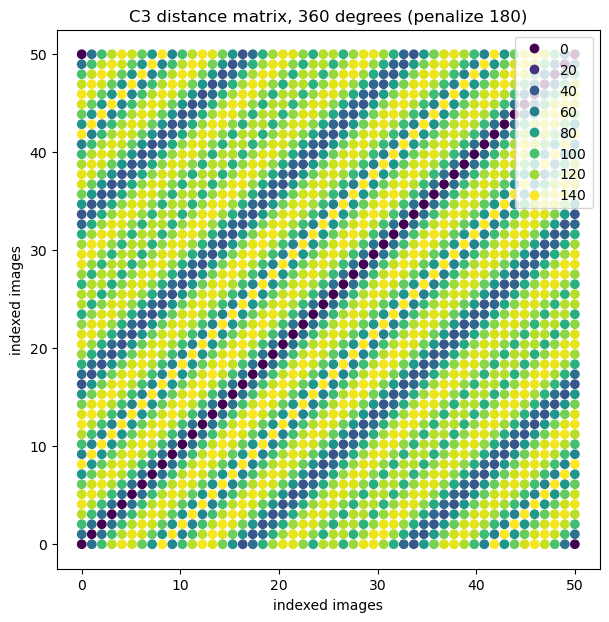

In [267]:
M = np.zeros((50,50))
for i in range(50):
    for j in range(50):
        M[i][j] = dist_penalize(points_in_R400[i], points_in_R400[j])
view_dist_matrix(matrix=M, num_pixels=50, window_size=50, title = 'C3 distance matrix, 360 degrees (penalize 180)')

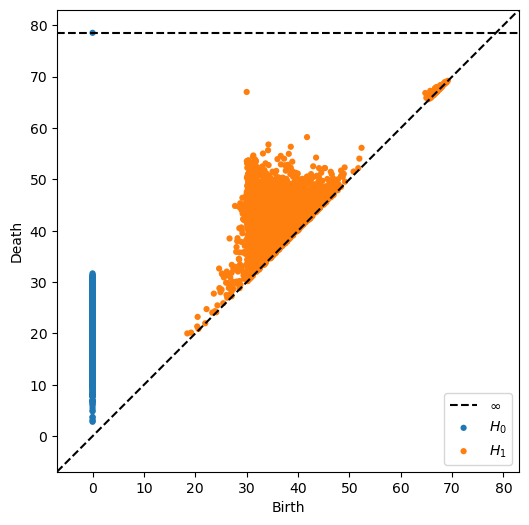

In [268]:
output = ripser(vectors, maxdim=1, coeff=2, metric=dist_penalize)
plot_dgms(output)

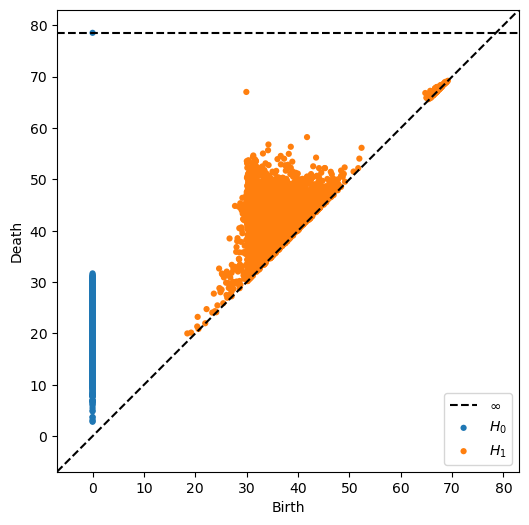

In [269]:
output = ripser(vectors, maxdim=1, coeff=3, metric=dist_penalize)
plot_dgms(output)

In [188]:
def dist_penalize(lens1, lens2):
    if pi - .5 < abs(lens1[0] - lens2[0]) < pi + .5:
        ret = 130 
    else:
        ret = dist(lens1[1:], lens2[1:])
    return ret

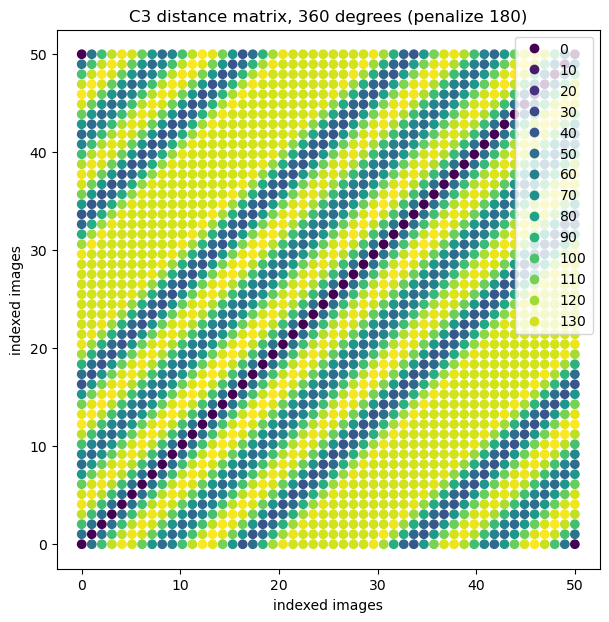

In [189]:
M = np.zeros((50,50))
for i in range(50):
    for j in range(50):
        M[i][j] = dist_penalize(points_in_R400[i], points_in_R400[j])
view_dist_matrix(matrix=M, num_pixels=50, window_size=50, title = 'C3 distance matrix, 360 degrees (penalize 180)')

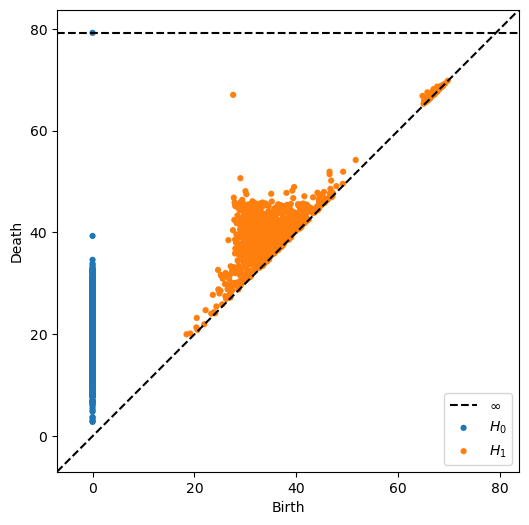

In [190]:
output = ripser(vectors, maxdim=1, coeff=2, metric=dist_penalize)
plot_dgms(output)

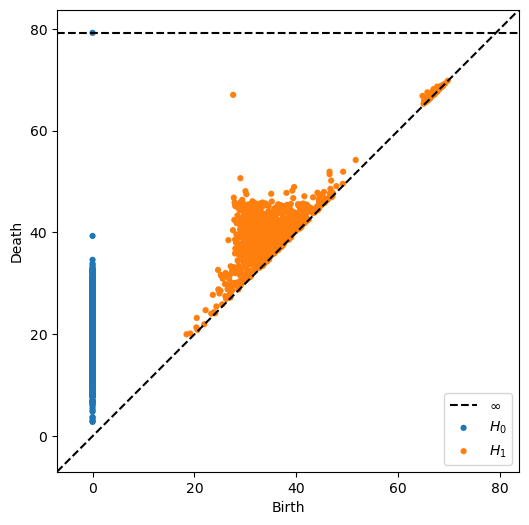

In [191]:
output = ripser(vectors, maxdim=1, coeff=3, metric=dist_penalize)
plot_dgms(output)

In [184]:
def dist_penalize(lens1, lens2):
    if (pi/3 - 0.2 < abs(lens1[0] - lens2[0]) < pi/3 + 0.2) or (pi - 0.2 < abs(lens1[0] - lens2[0]) < pi + 0.2) or (5*pi/3 - 0.2 < abs(lens1[0] - lens2[0]) < 5*pi/3 + 0.2):
        ret = 130
    else:
        ret = dist(lens1[1:], lens2[1:])
    return ret

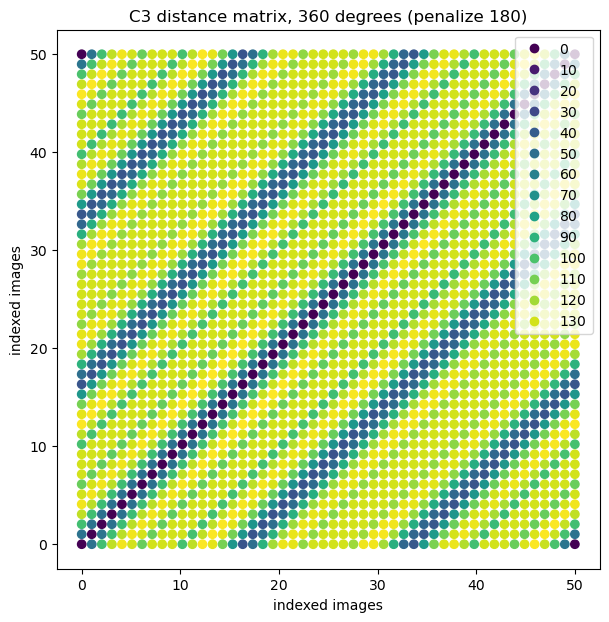

In [185]:
M = np.zeros((50,50))
for i in range(50):
    for j in range(50):
        M[i][j] = dist_penalize(points_in_R400[i], points_in_R400[j])
view_dist_matrix(matrix=M, num_pixels=50, window_size=50, title = 'C3 distance matrix, 360 degrees (penalize 180)')

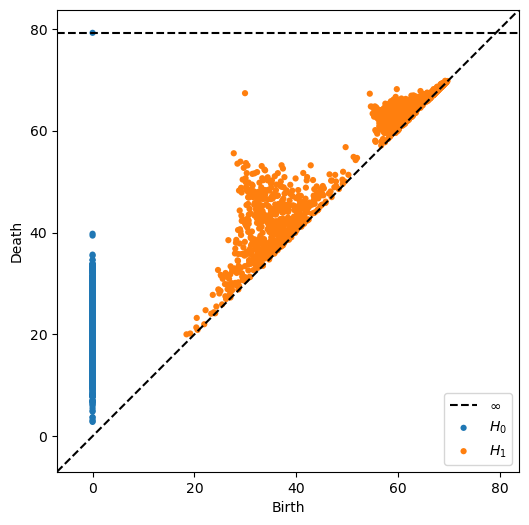

In [186]:
output = ripser(vectors, maxdim=1, coeff=2, metric=dist_penalize)
plot_dgms(output)

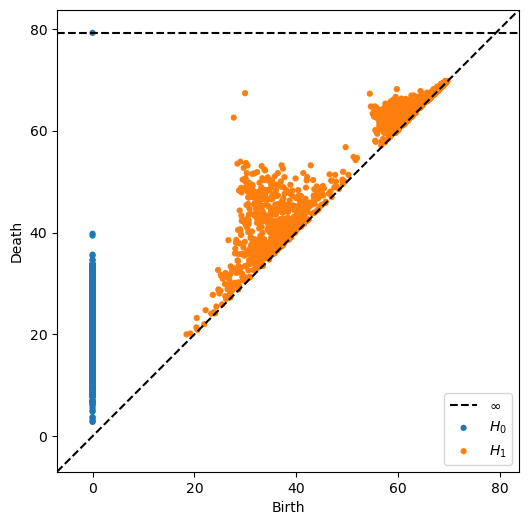

In [187]:
output = ripser(vectors, maxdim=1, coeff=3, metric=dist_penalize)
plot_dgms(output)

### Using the same penalizing function on C6

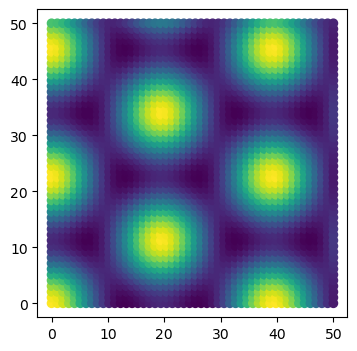

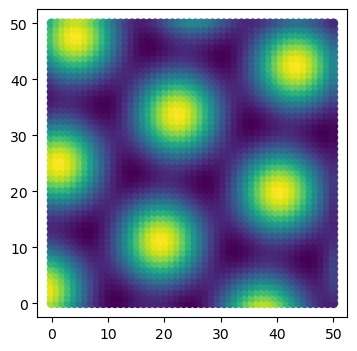

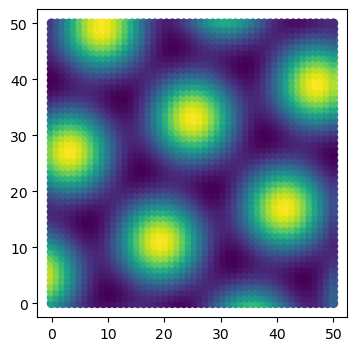

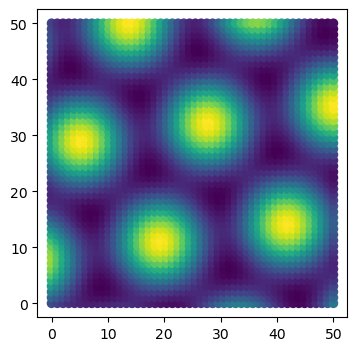

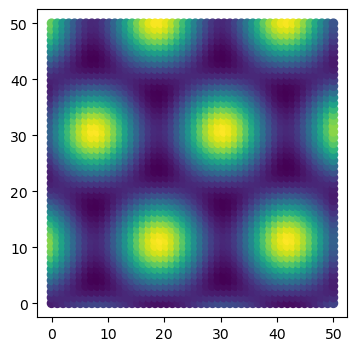

...

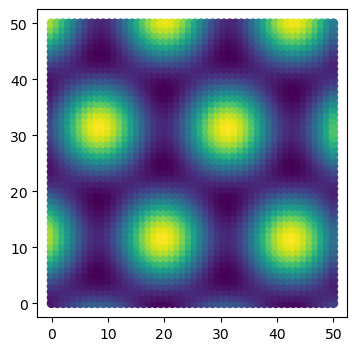

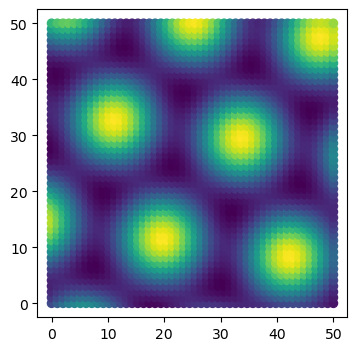

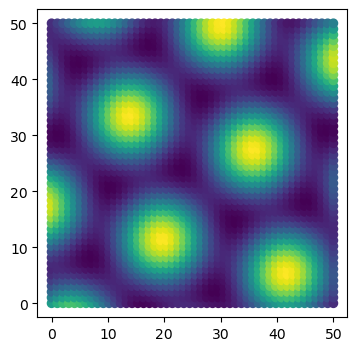

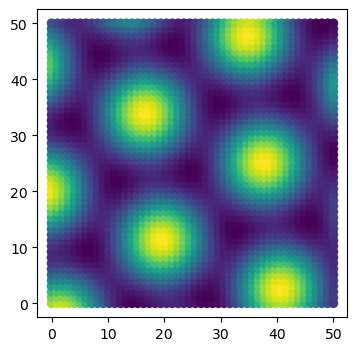

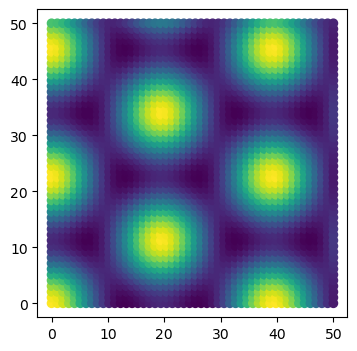

In [276]:
def p6(x,y):
    X = 1/(2 * pi) * (x + y / (3**(1/2)))
    Y = 1/(2 * pi) * 2 * y / (3**(1/2))
    C = cos(X + Y) + cos(X - 2 * Y) + cos(-2 * X + Y)
    S = sin(X + Y) +sin(X - 2*Y) +sin(-2 * X + Y)
    return C 

# yellow
isoms = []
for i in range(50):
    theta = (2*pi)/49 * i 
    isom1 = isom(-19,-12,0)
    isom2 = isom(0,0,theta)
    isom3 = isom(19,12,0)
    f = compose_isoms(isom1,isom2,isom3)
    isoms.append((theta, f))
    
points_in_R400 = []
for pair in isoms:
    view_isom2(isom_inv = pair[1],image_function =p6, num_pixels = 50, window_size =50)
    pixels = get_unitsq_pixels(num_pixels = 50, window_size=50)
    point = new_colors(pixels, iso_inv=pair[1], image_function=p6)
    point.insert(0, pair[0])
    points_in_R400.append(point)

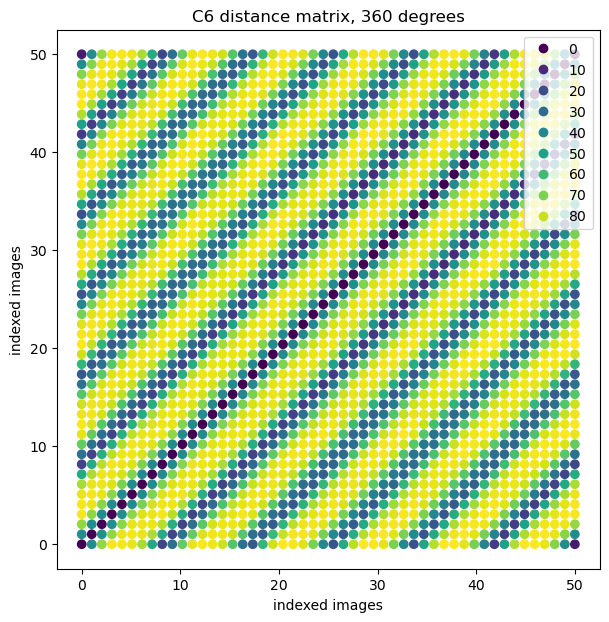

In [284]:
M = np.zeros((50,50))
for i in range(50):
    for j in range(50):
        M[i][j] = dist(points_in_R400[i], points_in_R400[j])
view_dist_matrix(matrix=M, num_pixels=50, window_size=50, title = 'C6 distance matrix, 360 degrees')

In [280]:
def dist_penalize(lens1, lens2):
    if (pi/3 - 0.2 < abs(lens1[0] - lens2[0]) < pi/3 + 0.2) or (pi - 0.2 < abs(lens1[0] - lens2[0]) < pi + 0.2) or (5*pi/3 - 0.2 < abs(lens1[0] - lens2[0]) < 5*pi/3 + 0.2):
        ret = 130
    else:
        ret = dist(lens1[1:], lens2[1:])
    return ret

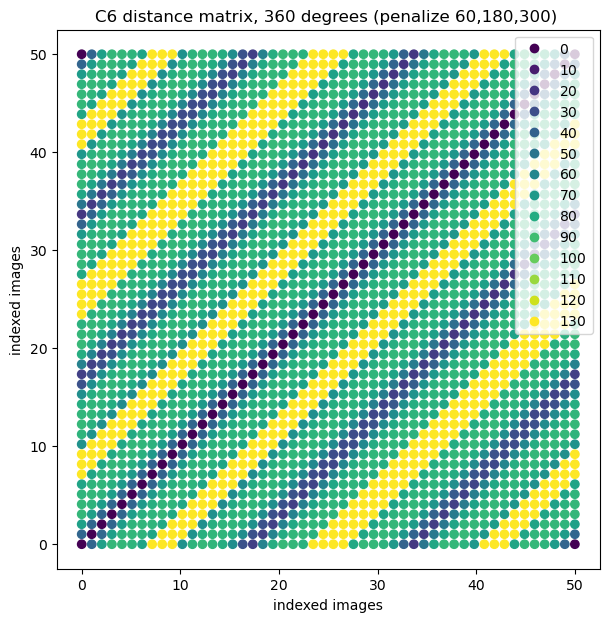

In [281]:
M = np.zeros((50,50))
for i in range(50):
    for j in range(50):
        M[i][j] = dist_penalize(points_in_R400[i], points_in_R400[j])
view_dist_matrix(matrix=M, num_pixels=50, window_size=50, title = 'C6 distance matrix, 360 degrees (penalize 60,180,300) ')

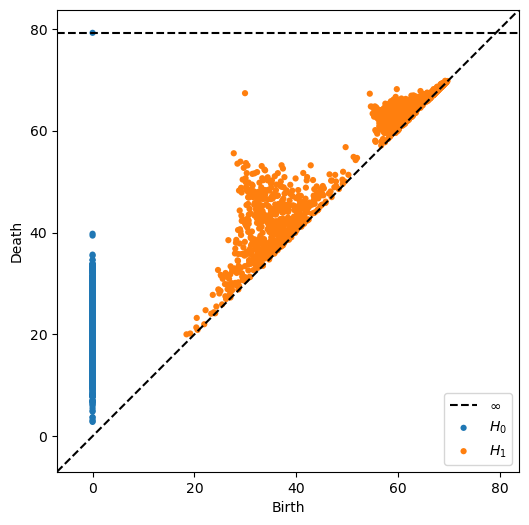

In [282]:
output = ripser(vectors, maxdim=1, coeff=2, metric=dist_penalize)
plot_dgms(output)

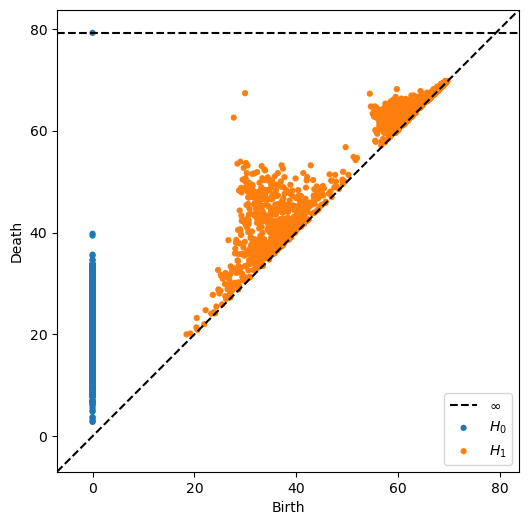

In [283]:
output = ripser(vectors, maxdim=1, coeff=3, metric=dist_penalize)
plot_dgms(output)

# C1

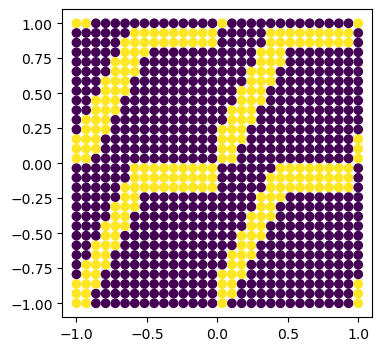

In [6]:
def slant(x,y):
    ret = 0
    if (0 <= x % 1 < 0.5) and (x % 1 - 0.1 <= 0.5* (y % 1) <= x%1 + 0.1):
        ret = 1
    if y % 1 > 0.8 and 0.5 < x % 1 < 1:
        ret = 1
    return ret

view_window_continuous(slant, 30,2)

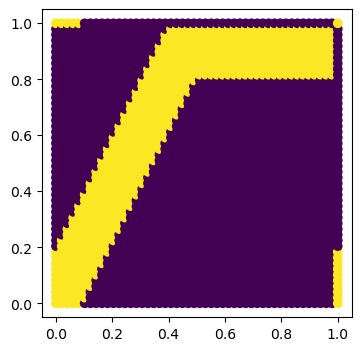

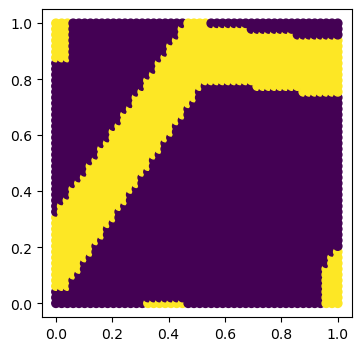

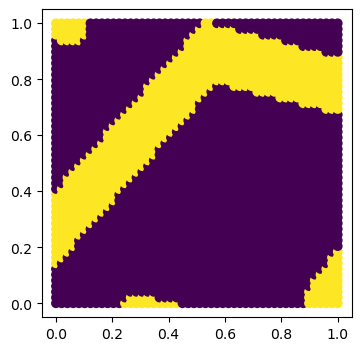

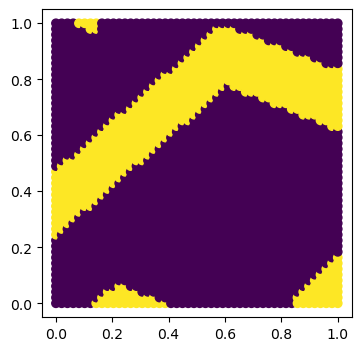

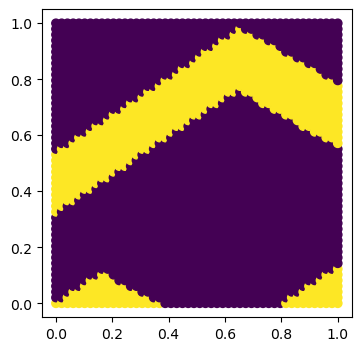

...

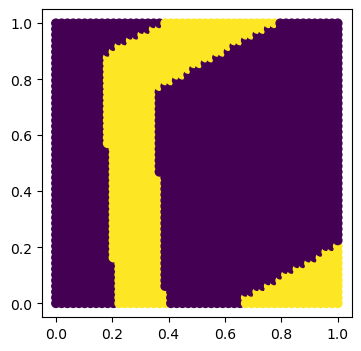

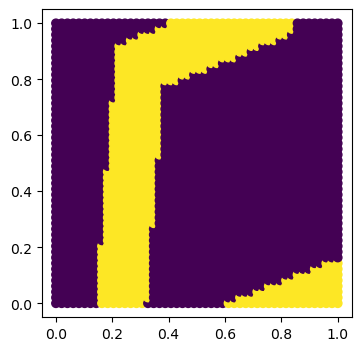

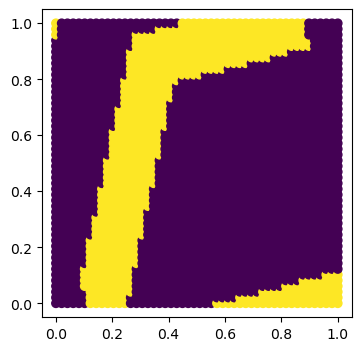

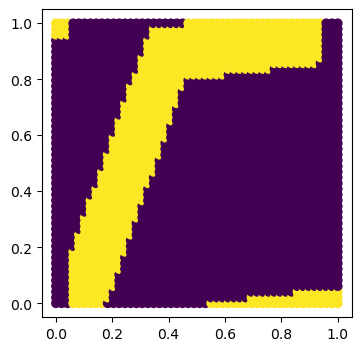

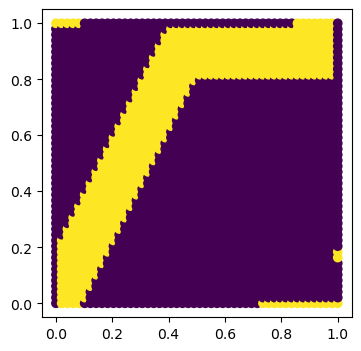

In [289]:
# center of lens
isoms = []
for i in range(50):
    theta = (2*pi)/49 * i 
    isom1 = isom(-.5,-.5,0)
    isom2 = isom(0,0,theta)
    isom3 = isom(.5,.5,0)
    f = compose_isoms(isom1,isom2,isom3)
    isoms.append((theta, f))
    
points_in_R400 = []
for pair in isoms:
    view_isom2(isom_inv = pair[1],image_function =slant, num_pixels = 50, window_size =1)
    pixels = get_unitsq_pixels(num_pixels = 50, window_size=1)
    point = new_colors(pixels, iso_inv=pair[1], image_function=slant)
    point.insert(0, pair[0])
    points_in_R400.append(point)

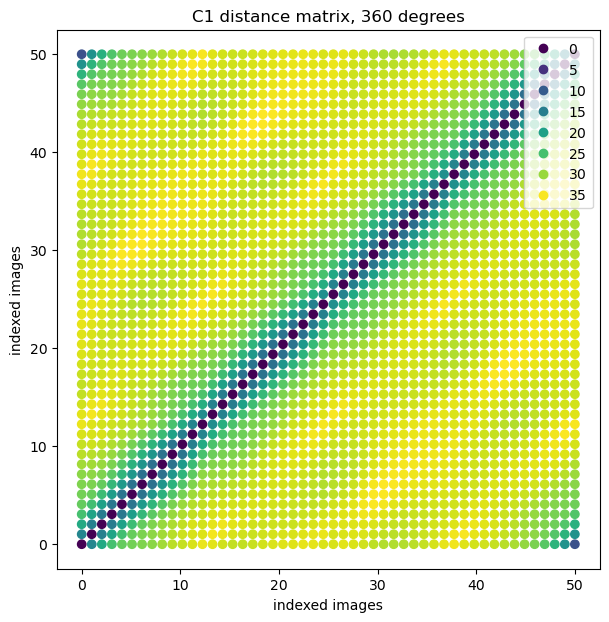

In [290]:
M = np.zeros((50,50))
for i in range(50):
    for j in range(50):
        M[i][j] = dist(points_in_R400[i], points_in_R400[j])
view_dist_matrix(matrix=M, num_pixels=50, window_size=50, title = 'C1 distance matrix, 360 degrees')

In [317]:
def dist_penalize(lens1, lens2):
    if pi - 0.1 < abs(lens1[0] - lens2[0]) < pi + 0.1:
        ret = 2 * dist(lens1[1:], lens2[1:])
    else:
        ret = dist(lens1[1:], lens2[1:])
    return ret

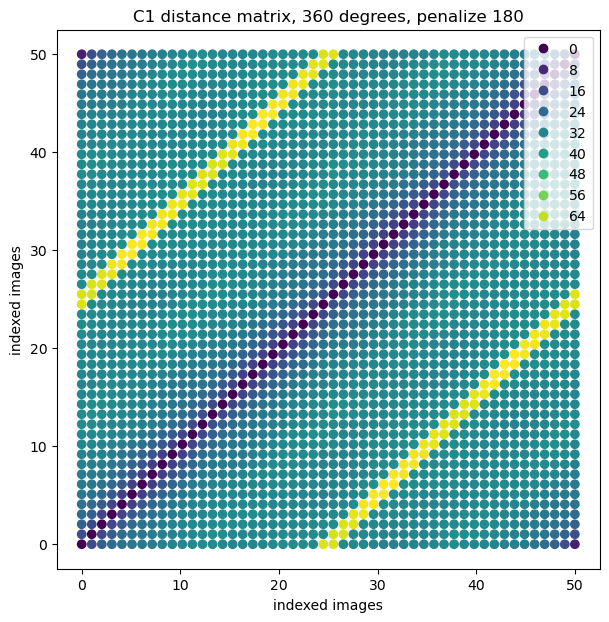

In [318]:
M = np.zeros((50,50))
for i in range(50):
    for j in range(50):
        M[i][j] = dist_penalize(points_in_R400[i], points_in_R400[j])
view_dist_matrix(matrix=M, num_pixels=50, window_size=50, title = 'C1 distance matrix, 360 degrees, penalize 180')

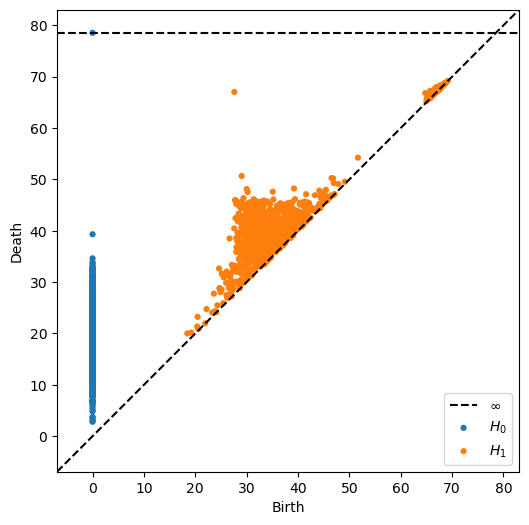

In [293]:
output = ripser(vectors, maxdim=1, coeff=2, metric=dist_penalize)
plot_dgms(output)

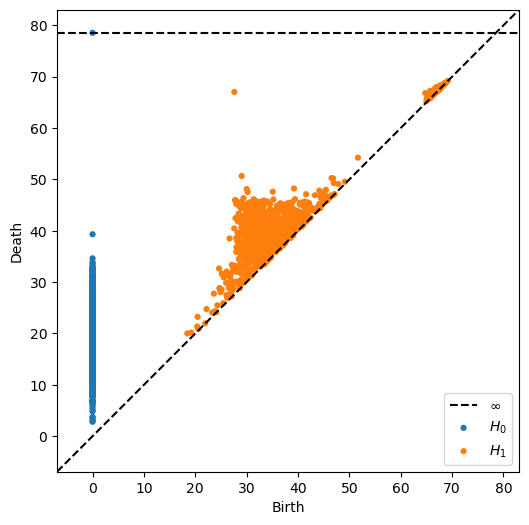

In [294]:
output = ripser(vectors, maxdim=1, coeff=2, metric=dist_penalize)
plot_dgms(output)

In [295]:
def dist_penalize(lens1, lens2):
    if (pi/3 - 0.2 < abs(lens1[0] - lens2[0]) < pi/3 + 0.2) or (pi - 0.2 < abs(lens1[0] - lens2[0]) < pi + 0.2) or (5*pi/3 - 0.2 < abs(lens1[0] - lens2[0]) < 5*pi/3 + 0.2):
        ret = 130
    else:
        ret = dist(lens1[1:], lens2[1:])
    return ret

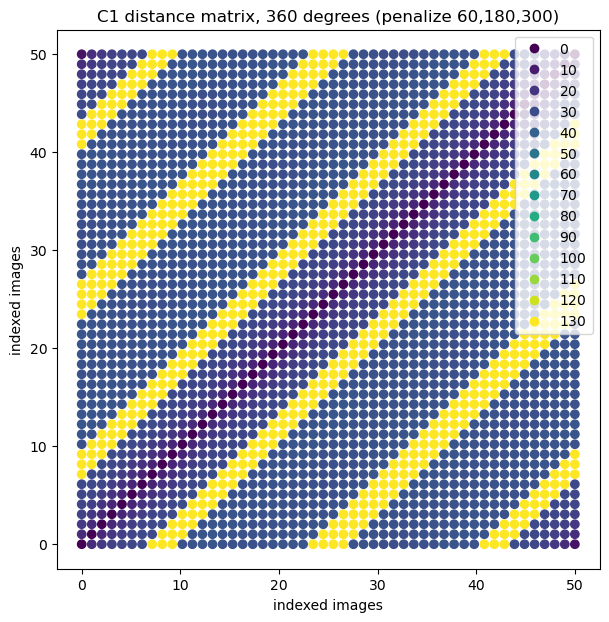

In [300]:
M = np.zeros((50,50))
for i in range(50):
    for j in range(50):
        M[i][j] = dist_penalize(points_in_R400[i], points_in_R400[j])
view_dist_matrix(matrix=M, num_pixels=50, window_size=50, title = 'C1 distance matrix, 360 degrees (penalize 60,180,300)')

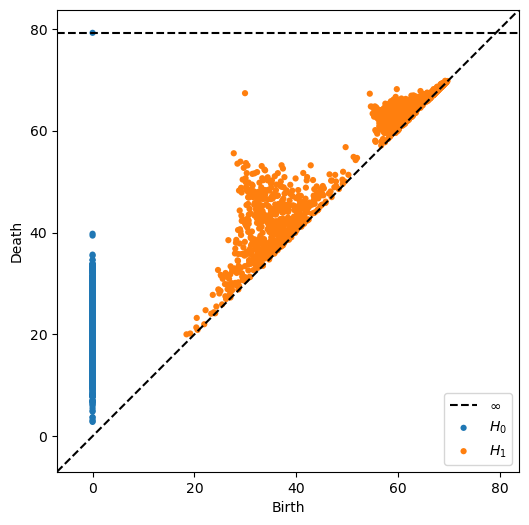

In [297]:
output = ripser(vectors, maxdim=1, coeff=2, metric=dist_penalize)
plot_dgms(output)

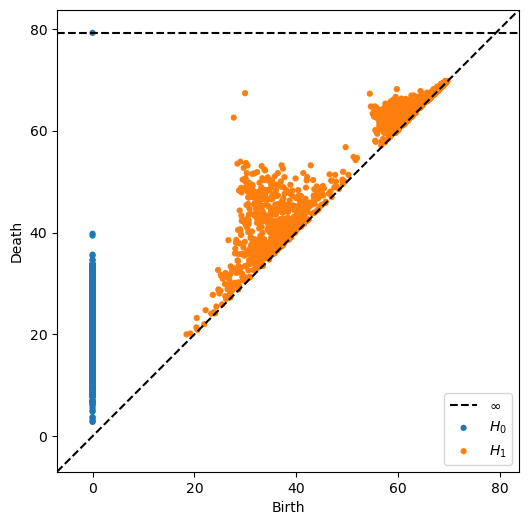

In [298]:
output = ripser(vectors, maxdim=1, coeff=3, metric=dist_penalize)
plot_dgms(output)

In [301]:
def dist_penalize(lens1, lens2):
    if pi - pi/2 < abs(lens1[0] - lens2[0]) < pi + pi/2:
        ret = (1 - cos(abs(lens1[0] - lens2[0]))) * dist(lens1[1:], lens2[1:])
    else:
        ret = dist(lens1[1:], lens2[1:])
    return ret

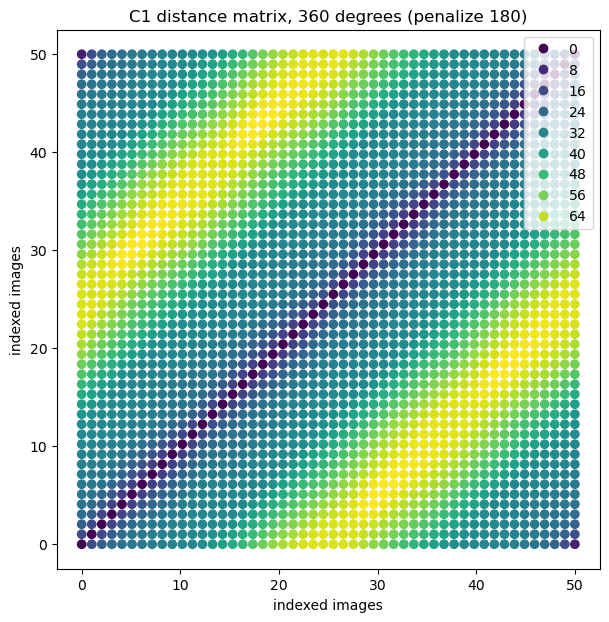

In [302]:
M = np.zeros((50,50))
for i in range(50):
    for j in range(50):
        M[i][j] = dist_penalize(points_in_R400[i], points_in_R400[j])
view_dist_matrix(matrix=M, num_pixels=50, window_size=50, title = 'C1 distance matrix, 360 degrees (penalize 180)')

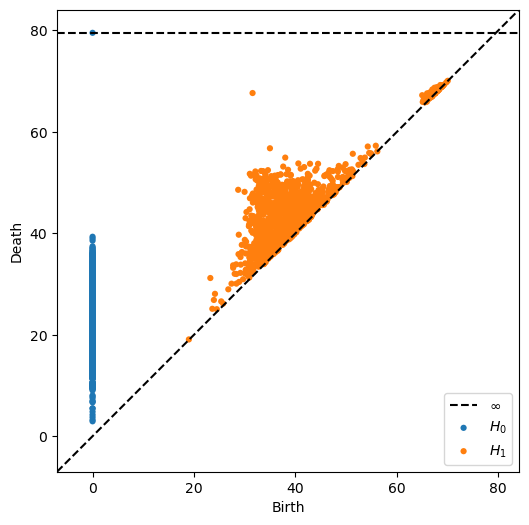

In [304]:
output = ripser(vectors, maxdim=1, coeff=2, metric=dist_penalize)
plot_dgms(output)

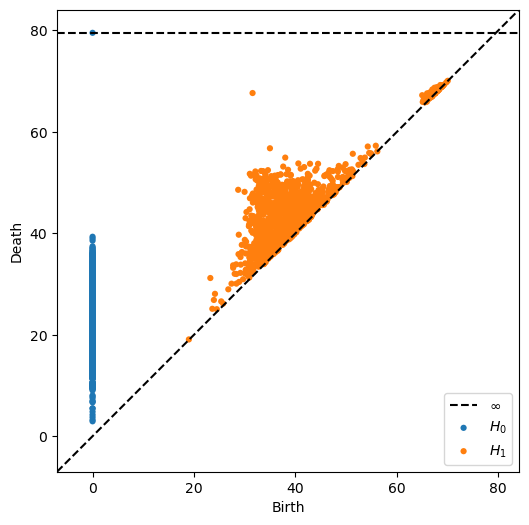

In [305]:
output = ripser(vectors, maxdim=1, coeff=3, metric=dist_penalize)
plot_dgms(output)